In [321]:
# https://app.slack.com/client/TC7N817RS/C01K0R7TUJV/thread/C01K0R7TUJV-1611345770.024700
# https://devpost.com/software/wind-energy-forecast-when-historical-data-is-limited



In [322]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import seaborn as sns

from keras.models import Sequential
from keras.layers import Dense
from sklearn.metrics import mean_squared_error
from keras.layers import LSTM

%matplotlib inline

In [323]:
path_ds1_forcast = "data/Dateset#1/Dataset1_forecast.csv"
path_ds1_measure = "data/Dateset#1/Dataset1_measurement.csv"

path_ds2_forcast = "data/Dateset#2/Dataset2_forecast.csv"
path_ds2_measure = "data/Dateset#2/Dataset2_measurement.csv"

path_ds3_forcast = "data/Dateset#1/Dataset3_forecast.csv"



In [324]:
measurement = pd.read_csv(path_ds1_measure, parse_dates=True)
measurement.timeStamp = pd.to_datetime(measurement.timeStamp)
measurement.columns =  ["time", "availablemw", "windspeed", "windpower"]

forecast = pd.read_csv(path_ds1_forcast, parse_dates=True)
forecast.Time = pd.to_datetime(forecast.Time)
forecast.columns = ["time","windspeed","windic"]

print(forecast.head())

print("\n")

print(measurement.head())

                 time  windspeed   windic
0 2018-01-01 00:00:00    9.50241  303.854
1 2018-01-01 01:00:00    8.60719  301.083
2 2018-01-01 02:00:00    8.43270  301.583
3 2018-01-01 03:00:00    8.16070  301.586
4 2018-01-01 04:00:00    8.10899  302.583


                 time availablemw windspeed windpower
0 2018-01-01 00:00:00        34.5      11.9   42.5118
1 2018-01-01 00:05:00        34.5        12   42.7067
2 2018-01-01 00:10:00        34.5        12   42.7067
3 2018-01-01 00:15:00        34.5      11.8   42.3044
4 2018-01-01 00:20:00        34.5      11.8   42.3044


In [325]:
forecast.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7388 entries, 0 to 7387
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   time       7388 non-null   datetime64[ns]
 1   windspeed  7388 non-null   float64       
 2   windic     7388 non-null   float64       
dtypes: datetime64[ns](1), float64(2)
memory usage: 173.3 KB


In [326]:
measurement.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 88941 entries, 0 to 88940
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   time         88941 non-null  datetime64[ns]
 1   availablemw  88941 non-null  object        
 2   windspeed    88941 non-null  object        
 3   windpower    88941 non-null  object        
dtypes: datetime64[ns](1), object(3)
memory usage: 2.7+ MB


In [233]:
def find_missing_index(data):
    '''
    - data (pandas dataframe): contains missing/nan/null values
    - return a list of distinct missing indices (= set)
    - return None if data has no missing values
    '''
    # select numeric columns only
    columns = data.select_dtypes(include=[np.number]).columns
    missing_indices = set()
    for col in columns:
        indices = data[data[col].isna()].index.values
        for idx in indices:
            missing_indices.add(idx)
    return sorted(list(missing_indices))


In [234]:
def timeseries_plot_all(df):
    '''Show box plots for each feature
    - df is a pandas dataframe whose index is time series,for exmple [2020-10-30 00:00:00, 2020-10-30 00:15:00]
    - The output will show 2 time series graph per row.
    
    '''
    # Select just the numeric features
    df = df.select_dtypes(include=[np.number])
    # Compute the layout grid size
    data_cols = len(df.columns)
    # the size of box
    unit_size = 10
    # 5 box on the same row
    layout_cols = 2
    layout_rows = int(data_cols/layout_cols + layout_cols)
    # Make the plots
    df.plot(subplots=True
            , figsize=(layout_cols*unit_size,layout_rows*unit_size)
            , layout=(layout_rows,layout_cols))
    # Adjust the legend position here        
    plt.legend(loc='upper right')
    plt.show()



In [235]:
def find_invalid_data(data):
    '''
    - data (pandas dataframe): contains missing/nan/null values
    - return a list of distinct missing indices (= set)
    - return None if data has no missing values
    '''
    # select numeric columns only
    columns = data.select_dtypes(include=[np.object]).columns
    #print(columns)
    missing_indices = set()
    for col in columns:
        indices = data[data[col].str.contains("N")].index.values
        #print(col, indices)
        for idx in indices:
            missing_indices.add(idx)
    return sorted(list(missing_indices))

In [236]:
# convert series to supervised learning
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
	n_vars = 1 if type(data) is list else data.shape[1]
	df = pd.DataFrame(data)
	cols, names = list(), list()
	# input sequence (t-n, ... t-1)
	for i in range(n_in, 0, -1):
		cols.append(df.shift(i))
		names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
	# forecast sequence (t, t+1, ... t+n)
	for i in range(0, n_out):
		cols.append(df.shift(-i))
		if i == 0:
			names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
		else:
			names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
	# put it all together
	agg = pd.concat(cols, axis=1)
	agg.columns = names
	# drop rows with NaN values
	if dropnan:
		agg.dropna(inplace=True)
	return agg


In [237]:
find_missing_index(forecast)

[]

In [238]:
find_missing_index(measurement)

[]

No handles with labels found to put in legend.


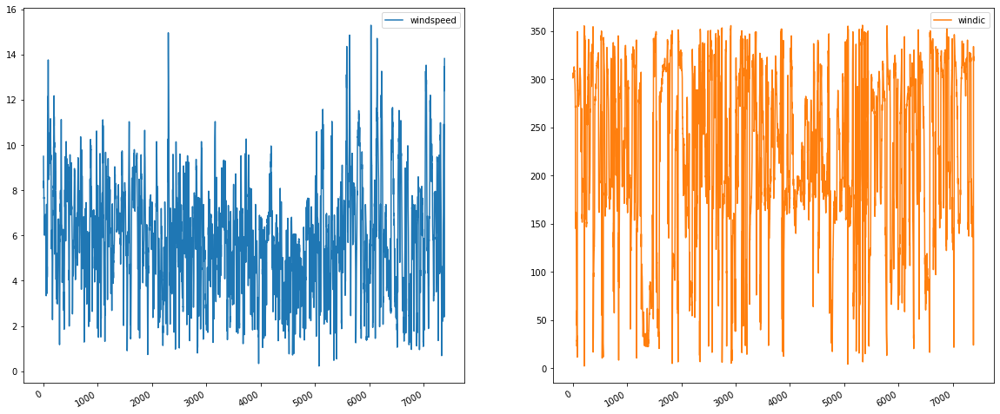

In [239]:
timeseries_plot_all(forecast)

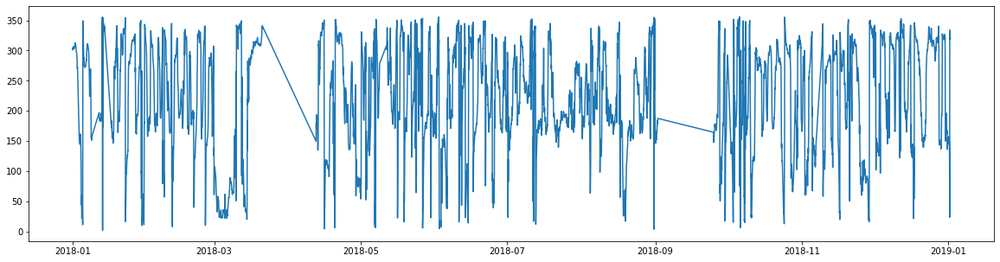

In [240]:
plt.figure(figsize=(20, 5))
plt.plot(forecast.set_index('time').windic)

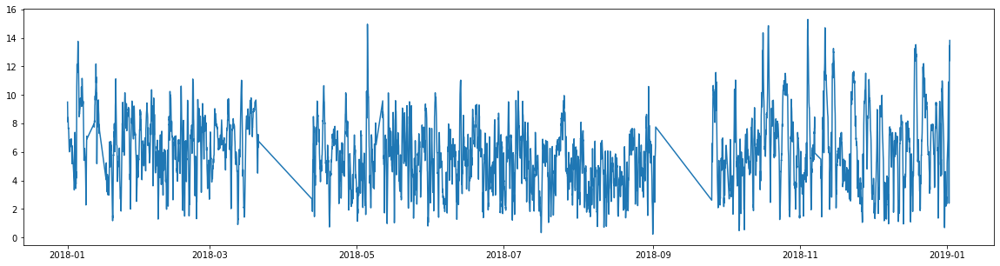

In [241]:
plt.figure(figsize=(20, 5))
plt.plot(forecast.set_index('time').windspeed)

<AxesSubplot:>

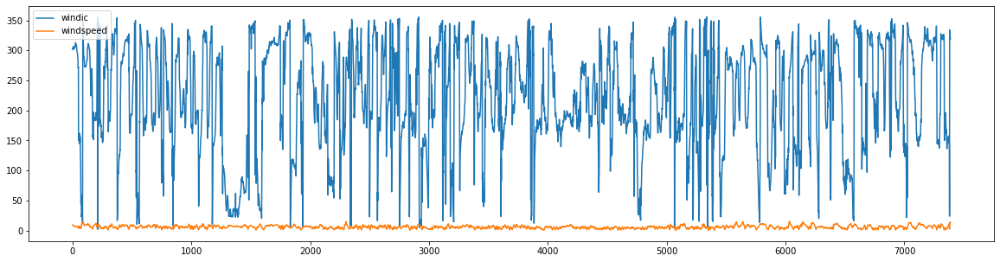

In [242]:
# relation between windspeed and wind direction
forecast[["windic", "windspeed"]].plot(kind="line", figsize=(20, 5))

In [243]:
measurement.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 88941 entries, 0 to 88940
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   time         88941 non-null  datetime64[ns]
 1   availablemw  88941 non-null  object        
 2   windspeed    88941 non-null  object        
 3   windpower    88941 non-null  object        
dtypes: datetime64[ns](1), object(3)
memory usage: 2.7+ MB


In [244]:
# show the numner of rows that contain the invalid character '\n'
invalid_index = find_invalid_data(measurement)

measurement.iloc[invalid_index]

,time,availablemw,windspeed,windpower
1073,2018-01-04 17:25:00,\N,7.6,16.0383
1901,2018-01-07 14:25:00,\N,11,39.9904
1902,2018-01-07 14:30:00,\N,11.2,40.7016
5300,2018-01-19 09:40:00,\N,\N,\N
6376,2018-01-23 03:20:00,\N,\N,\N
...,...,...,...,...
83123,2018-12-10 19:15:00,\N,8.6,22.641
83124,2018-12-10 19:20:00,\N,8.8,24.2374
85929,2018-12-20 13:05:00,\N,6.1,7.43422
85930,2018-12-20 13:10:00,\N,6.1,7.43422


# Filling the missing values: 
I come up with some approaches: 
- 1) filling them with 0, 
- 2) linear interpolation
- 3) polynomial interpolation


## 1) Filling invalid data with 0

<AxesSubplot:xlabel='time'>

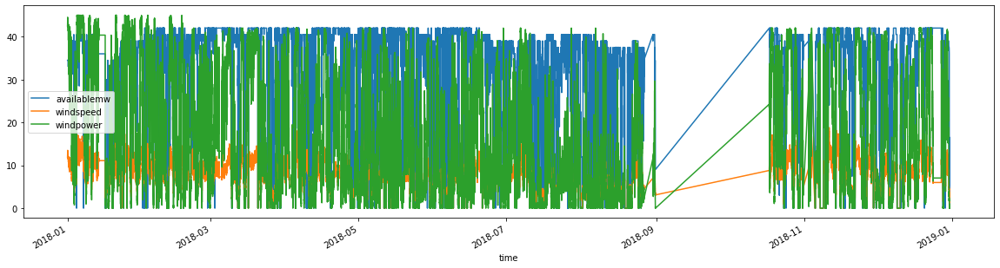

In [245]:
# replace \N by NaN
fillna_measurement = measurement.copy()

fillna_measurement[["availablemw", "windspeed", "windpower"]] = fillna_measurement[["availablemw", "windspeed", "windpower"]].replace(r'\\N', np.nan, regex=True) 

# fill NaN with 0
fillna_measurement = fillna_measurement.fillna(0)

# change data types of columns of from object to numeric
fillna_measurement[["availablemw", "windspeed", "windpower"]] = fillna_measurement[["availablemw", "windspeed", "windpower"]].astype(np.float)

# plot the dataset to see the trend
fillna_measurement.set_index("time").plot(figsize = (20, 5))


No handles with labels found to put in legend.


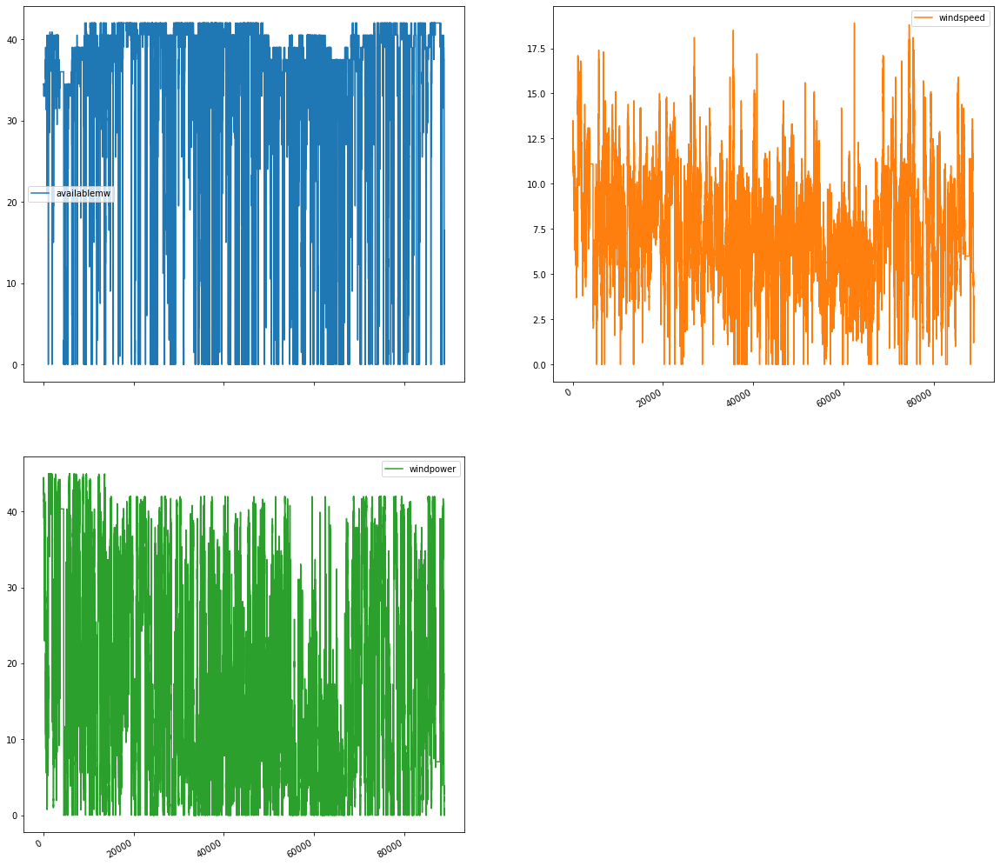

In [246]:
timeseries_plot_all(fillna_measurement)

<AxesSubplot:xlabel='time'>

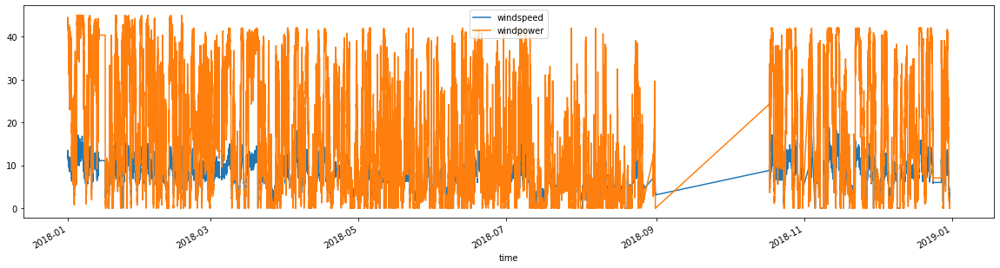

In [247]:
fillna_measurement.set_index("time")[["windspeed", "windpower"]].plot(figsize = (20, 5))

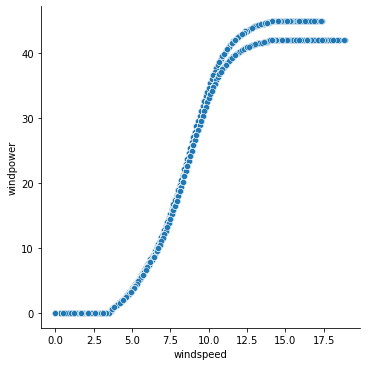

In [248]:
# plot regression between windpped and windpower after filling invalid values with 0
sns.relplot(fillna_measurement.windspeed, fillna_measurement.windpower)

## 2) Filling the invalid data with linear interpolation

                     time  availablemw  windspeed  windpower
1073  2018-01-04 17:25:00        38.25        7.6  16.038300
1901  2018-01-07 14:25:00        40.50       11.0  39.990400
1902  2018-01-07 14:30:00        40.50       11.2  40.701600
5300  2018-01-19 09:40:00        34.50        6.3   8.751215
6376  2018-01-23 03:20:00         4.35        3.0   0.000000
...                   ...          ...        ...        ...
83123 2018-12-10 19:15:00        42.00        8.6  22.641000
83124 2018-12-10 19:20:00        42.00        8.8  24.237400
85929 2018-12-20 13:05:00        40.50        6.1   7.434220
85930 2018-12-20 13:10:00        40.50        6.1   7.434220
88216 2018-12-28 11:40:00        39.00        7.7  15.875300

[906 rows x 4 columns]


<AxesSubplot:xlabel='time'>

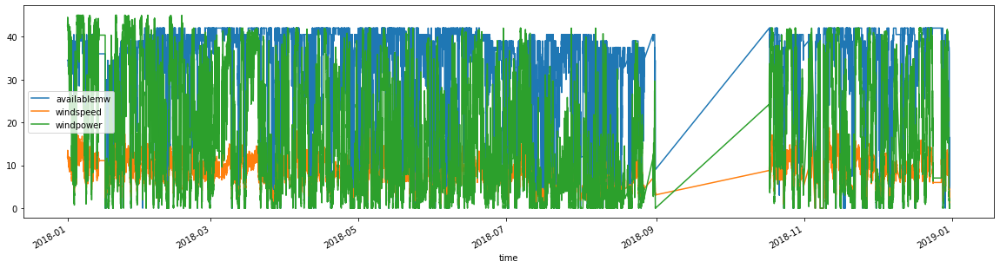

In [249]:
# replace \N by NaN
fillna_measurement = measurement.copy()

fillna_measurement[["availablemw", "windspeed", "windpower"]] = fillna_measurement[["availablemw", "windspeed", "windpower"]].replace(r'\\N', np.nan, regex=True) 

# change data types of columns of from object to numeric
fillna_measurement[["availablemw", "windspeed", "windpower"]] = fillna_measurement[["availablemw", "windspeed", "windpower"]].astype(np.float)

# fill NaN with linear interpolation
fillna_measurement = fillna_measurement.interpolate(method = "linear")

print(fillna_measurement.iloc[invalid_index])

#plot the dataset to see the trend
fillna_measurement.set_index("time").plot(figsize = (20, 5))

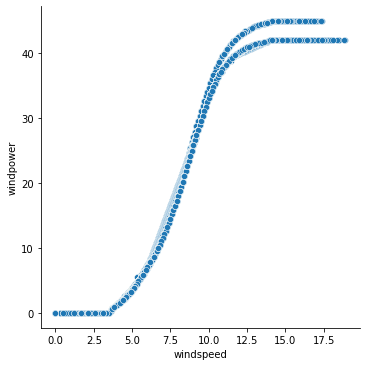

In [250]:
# plot regression between windpped and windpower after filling invalid values with linear interplation
sns.relplot(fillna_measurement.windspeed, fillna_measurement.windpower)

## 3) Filling the invalid data with Polynomial interpolation

                     time  availablemw  windspeed  windpower
1073  2018-01-04 17:25:00    38.249798   7.600000  16.038300
1901  2018-01-07 14:25:00    40.500011  11.000000  39.990400
1902  2018-01-07 14:30:00    40.500030  11.200000  40.701600
5300  2018-01-19 09:40:00    34.500000   6.313182   8.808911
6376  2018-01-23 03:20:00     2.898213   2.844391  -0.007683
...                   ...          ...        ...        ...
83123 2018-12-10 19:15:00    41.999997   8.600000  22.641000
83124 2018-12-10 19:20:00    41.999999   8.800000  24.237400
85929 2018-12-20 13:05:00    40.454801   6.100000   7.434220
85930 2018-12-20 13:10:00    40.382433   6.100000   7.434220
88216 2018-12-28 11:40:00    38.999951   7.746046  16.180639

[906 rows x 4 columns]


<AxesSubplot:xlabel='time'>

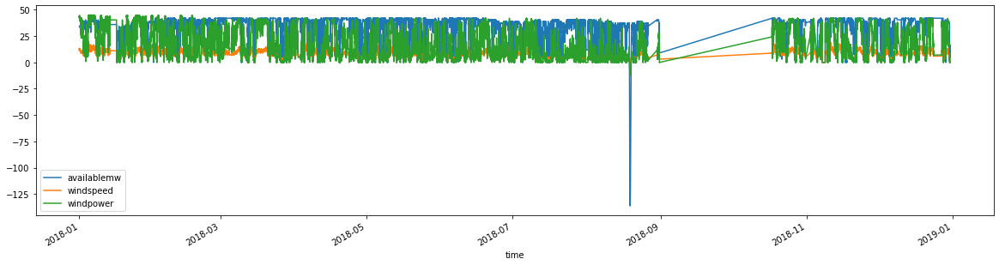

In [251]:
# replace \N by NaN
fillna_measurement = measurement.copy()

fillna_measurement[["availablemw", "windspeed", "windpower"]] = fillna_measurement[["availablemw", "windspeed", "windpower"]].replace(r'\\N', np.nan, regex=True) 

# change data types of columns of from object to numeric
fillna_measurement[["availablemw", "windspeed", "windpower"]] = fillna_measurement[["availablemw", "windspeed", "windpower"]].astype(np.float)

# fill NaN with linear interpolation
fillna_measurement = fillna_measurement.interpolate(method='polynomial', order = 2)

print(fillna_measurement.iloc[invalid_index])

#plot the dataset to see the trend
fillna_measurement.set_index("time").plot(figsize = (20, 5))

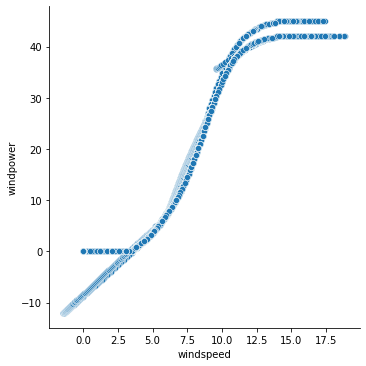

In [252]:
# plot regression between windpped and windpower after filling values with polynomial interpolation
sns.relplot(fillna_measurement.windspeed, fillna_measurement.windpower)

In [253]:
# since linear interpolation is a good method to fill the invalid values, I will apply on measurement dataset

measurement[["availablemw", "windspeed", "windpower"]] = measurement[["availablemw", "windspeed", "windpower"]].replace(r'\\N', np.nan, regex=True) 

# change data types of columns of from object to numeric
measurement[["availablemw", "windspeed", "windpower"]] = measurement[["availablemw", "windspeed", "windpower"]].astype(np.float)

# fill NaN with linear interpolation
measurement = measurement.interpolate(method = "linear")

measurement.iloc[invalid_index]

,time,availablemw,windspeed,windpower
1073,2018-01-04 17:25:00,38.25,7.6,16.038300
1901,2018-01-07 14:25:00,40.50,11.0,39.990400
1902,2018-01-07 14:30:00,40.50,11.2,40.701600
5300,2018-01-19 09:40:00,34.50,6.3,8.751215
6376,2018-01-23 03:20:00,4.35,3.0,0.000000
...,...,...,...,...
83123,2018-12-10 19:15:00,42.00,8.6,22.641000
83124,2018-12-10 19:20:00,42.00,8.8,24.237400
85929,2018-12-20 13:05:00,40.50,6.1,7.434220
85930,2018-12-20 13:10:00,40.50,6.1,7.434220


In [254]:
forecast.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7388 entries, 0 to 7387
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   time       7388 non-null   datetime64[ns]
 1   windspeed  7388 non-null   float64       
 2   windic     7388 non-null   float64       
dtypes: datetime64[ns](1), float64(2)
memory usage: 173.3 KB


In [255]:
measurement.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 88941 entries, 0 to 88940
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   time         88941 non-null  datetime64[ns]
 1   availablemw  88941 non-null  float64       
 2   windspeed    88941 non-null  float64       
 3   windpower    88941 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.7 MB


In [256]:
measurement.columns = ['measure_time', 'measure_availablemw', 'measure_windspeed', 'measure_windpower']

forecast.columns = ['forecast_time', 'forecast_windspeed', 'forcast_windic']

In [257]:
measurement.head(13)

,measure_time,measure_availablemw,measure_windspeed,measure_windpower
0,2018-01-01 00:00:00,34.5,11.9,42.5118
1,2018-01-01 00:05:00,34.5,12.0,42.7067
2,2018-01-01 00:10:00,34.5,12.0,42.7067
3,2018-01-01 00:15:00,34.5,11.8,42.3044
4,2018-01-01 00:20:00,34.5,11.8,42.3044
5,2018-01-01 00:25:00,34.5,12.4,43.3869
6,2018-01-01 00:30:00,34.5,12.4,43.3869
7,2018-01-01 00:35:00,34.5,12.3,43.2298
8,2018-01-01 00:40:00,34.5,12.3,43.2298
9,2018-01-01 00:45:00,34.5,12.3,43.2298


In [258]:
forecast.head(2)

,forecast_time,forecast_windspeed,forcast_windic
0,2018-01-01 00:00:00,9.50241,303.854
1,2018-01-01 01:00:00,8.60719,301.083


In [259]:
# combine 2 measurement and forcast dataset
forecast_measure = forecast.merge(measurement, left_on='forecast_time', right_on = "measure_time", how="left")#pd.merge(measurement, forecast, how="left")

forecast_measure.head()

,forecast_time,forecast_windspeed,forcast_windic,measure_time,measure_availablemw,measure_windspeed,measure_windpower
0,2018-01-01 00:00:00,9.50241,303.854,2018-01-01 00:00:00,34.5,11.9,42.5118
1,2018-01-01 01:00:00,8.60719,301.083,2018-01-01 01:00:00,34.5,13.0,44.1584
2,2018-01-01 02:00:00,8.43270,301.583,2018-01-01 02:00:00,34.5,13.0,44.1584
3,2018-01-01 03:00:00,8.16070,301.586,2018-01-01 03:00:00,34.5,12.6,43.6778
4,2018-01-01 04:00:00,8.10899,302.583,2018-01-01 04:00:00,34.5,12.3,43.2298


In [260]:
# combine 2 measurement and forcast dataset
measure_forecast = measurement.merge(forecast, right_on='forecast_time', left_on = "measure_time", how="left")
measure_forecast.head()

,measure_time,measure_availablemw,measure_windspeed,measure_windpower,forecast_time,forecast_windspeed,forcast_windic
0,2018-01-01 00:00:00,34.5,11.9,42.5118,2018-01-01,9.50241,303.854
1,2018-01-01 00:05:00,34.5,12.0,42.7067,NaT,NaN,NaN
2,2018-01-01 00:10:00,34.5,12.0,42.7067,NaT,NaN,NaN
3,2018-01-01 00:15:00,34.5,11.8,42.3044,NaT,NaN,NaN
4,2018-01-01 00:20:00,34.5,11.8,42.3044,NaT,NaN,NaN


In [261]:
measure_forecast.head(30)

,measure_time,measure_availablemw,measure_windspeed,measure_windpower,forecast_time,forecast_windspeed,forcast_windic
0,2018-01-01 00:00:00,34.5,11.9,42.5118,2018-01-01 00:00:00,9.50241,303.854
1,2018-01-01 00:05:00,34.5,12.0,42.7067,NaT,NaN,NaN
2,2018-01-01 00:10:00,34.5,12.0,42.7067,NaT,NaN,NaN
3,2018-01-01 00:15:00,34.5,11.8,42.3044,NaT,NaN,NaN
4,2018-01-01 00:20:00,34.5,11.8,42.3044,NaT,NaN,NaN
5,2018-01-01 00:25:00,34.5,12.4,43.3869,NaT,NaN,NaN
6,2018-01-01 00:30:00,34.5,12.4,43.3869,NaT,NaN,NaN
7,2018-01-01 00:35:00,34.5,12.3,43.2298,NaT,NaN,NaN
8,2018-01-01 00:40:00,34.5,12.3,43.2298,NaT,NaN,NaN
9,2018-01-01 00:45:00,34.5,12.3,43.2298,NaT,NaN,NaN


In [262]:
data = measure_forecast[["measure_time", "measure_windspeed", "measure_windpower", "forecast_windspeed","forcast_windic"]]

data.head()

,measure_time,measure_windspeed,measure_windpower,forecast_windspeed,forcast_windic
0,2018-01-01 00:00:00,11.9,42.5118,9.50241,303.854
1,2018-01-01 00:05:00,12.0,42.7067,NaN,NaN
2,2018-01-01 00:10:00,12.0,42.7067,NaN,NaN
3,2018-01-01 00:15:00,11.8,42.3044,NaN,NaN
4,2018-01-01 00:20:00,11.8,42.3044,NaN,NaN


In [263]:
data.tail()

,measure_time,measure_windspeed,measure_windpower,forecast_windspeed,forcast_windic
88936,2018-12-30 23:40:00,3.3,0.0,NaN,NaN
88937,2018-12-30 23:45:00,3.1,0.0,NaN,NaN
88938,2018-12-30 23:50:00,3.1,0.0,NaN,NaN
88939,2018-12-30 23:55:00,3.1,0.0,NaN,NaN
88940,2018-12-31 00:00:00,3.1,0.0,3.47313,173.380111


In [306]:
# count the number of rows whose wind power is 0
sum(data.measure_windpower == 0)

7820

In [309]:
data.measure_windpower = data.measure_windpower.replace(0, np.nan)
sum(data.measure_windpower == 0)

0

In [310]:
# fill the nan values with linear interpolation
data.interpolate(method='linear', inplace=True)

In [330]:
sum(data.measure_windpower == 0)

0

In [313]:
data.head(20)

,measure_time,measure_windspeed,measure_windpower,forecast_windspeed,forcast_windic
0,2018-01-01 00:00:00,11.9,42.5118,9.502410,303.854000
1,2018-01-01 00:05:00,12.0,42.7067,9.427808,303.623083
2,2018-01-01 00:10:00,12.0,42.7067,9.353207,303.392167
3,2018-01-01 00:15:00,11.8,42.3044,9.278605,303.161250
4,2018-01-01 00:20:00,11.8,42.3044,9.204003,302.930333
5,2018-01-01 00:25:00,12.4,43.3869,9.129402,302.699417
6,2018-01-01 00:30:00,12.4,43.3869,9.054800,302.468500
7,2018-01-01 00:35:00,12.3,43.2298,8.980198,302.237583
8,2018-01-01 00:40:00,12.3,43.2298,8.905597,302.006667
9,2018-01-01 00:45:00,12.3,43.2298,8.830995,301.775750


In [266]:
split_point = int(6.5 * 12)

split_point

78

In [267]:
data.head()

,measure_time,measure_windspeed,measure_windpower,forecast_windspeed,forcast_windic
0,2018-01-01 00:00:00,11.9,42.5118,9.502410,303.854000
1,2018-01-01 00:05:00,12.0,42.7067,9.427808,303.623083
2,2018-01-01 00:10:00,12.0,42.7067,9.353207,303.392167
3,2018-01-01 00:15:00,11.8,42.3044,9.278605,303.161250
4,2018-01-01 00:20:00,11.8,42.3044,9.204003,302.930333


In [268]:
'''
test = data[["measure_time", "measure_windspeed", "forecast_windspeed", "forcast_windic"]]

test = series_to_supervised(test)

test1, test2 = test[: (n - split_point - 1)], test[- split_point : ]
'''

'\ntest = data[["measure_time", "measure_windspeed", "forecast_windspeed", "forcast_windic"]]\n\ntest = series_to_supervised(test)\n\ntest1, test2 = test[: (n - split_point - 1)], test[- split_point : ]\n'

In [331]:
X = data[["measure_windspeed", "forecast_windspeed", "forcast_windic"]]

n = len(X)

X_sequence = series_to_supervised(X).values

x_train, x_test = X_sequence[: (n - split_point - 1)], X_sequence[- split_point : ]

Y = data[["measure_windpower"]]

y_train, y_test = Y[: (n - split_point - 1)], Y[- split_point : ]

# reshape input to be 3D [samples, timesteps, features]
x_train = x_train.reshape((x_train.shape[0], 1, x_train.shape[1]))

x_test = x_test.reshape((x_test.shape[0], 1, x_test.shape[1]))

print(x_train.shape, y_train.shape, x_test.shape, y_test.shape )

(88862, 1, 6) (88862, 1) (78, 1, 6) (78, 1)


In [336]:
sum(Y.measure_windpower == 0)

0

In [337]:
sum(y_test.measure_windpower == 0)

0

In [338]:
sum(y_train.measure_windpower == 0)

0

In [276]:
'''
sequence_x_train = series_to_supervised(x_train.drop(columns=["measure_time"]).values)

sequence_x_test = series_to_supervised(x_test.drop(columns=["measure_time"]).values)

sequence_x_train = sequence_x_train.values

sequence_x_test = sequence_x_test.values

y_train = y_train.values

y_test = y_test.values

#sequence_train_y = series_to_supervised(y_train.values)

#sequence_test_y = series_to_supervised(y_test.values)
'''

'\nsequence_x_train = series_to_supervised(x_train.drop(columns=["measure_time"]).values)\n\nsequence_x_test = series_to_supervised(x_test.drop(columns=["measure_time"]).values)\n\nsequence_x_train = sequence_x_train.values\n\nsequence_x_test = sequence_x_test.values\n\ny_train = y_train.values\n\ny_test = y_test.values\n\n#sequence_train_y = series_to_supervised(y_train.values)\n\n#sequence_test_y = series_to_supervised(y_test.values)\n'

In [277]:
# reshape input to be 3D [samples, timesteps, features]
'''
sequence_x_train = sequence_x_train.reshape((sequence_x_train.shape[0], 1, sequence_x_train.shape[1]))

sequence_x_test = sequence_x_test.reshape((sequence_x_test.shape[0], 1, sequence_x_test.shape[1]))

print(sequence_x_train.shape, sequence_x_test.shape, y_train.shape, y_test.shape )
'''

'\nsequence_x_train = sequence_x_train.reshape((sequence_x_train.shape[0], 1, sequence_x_train.shape[1]))\n\nsequence_x_test = sequence_x_test.reshape((sequence_x_test.shape[0], 1, sequence_x_test.shape[1]))\n\nprint(sequence_x_train.shape, sequence_x_test.shape, y_train.shape, y_test.shape )\n'

In [281]:
x_test.shape

(78, 1, 6)

Epoch 1/100
1235/1235 - 10s - loss: 251.2730 - val_loss: 202.6826
Epoch 2/100
1235/1235 - 4s - loss: 191.9987 - val_loss: 232.3134
Epoch 3/100
1235/1235 - 4s - loss: 189.2471 - val_loss: 257.3472
Epoch 4/100
1235/1235 - 4s - loss: 187.4320 - val_loss: 281.5128
Epoch 5/100
1235/1235 - 5s - loss: 190.7744 - val_loss: 199.2993
Epoch 6/100
1235/1235 - 5s - loss: 192.9659 - val_loss: 326.6979
Epoch 7/100
1235/1235 - 4s - loss: 182.4413 - val_loss: 246.0148
Epoch 8/100
1235/1235 - 6s - loss: 185.8244 - val_loss: 248.8531
Epoch 9/100
1235/1235 - 5s - loss: 187.9570 - val_loss: 196.9607
Epoch 10/100
1235/1235 - 5s - loss: 193.6476 - val_loss: 217.0745
Epoch 11/100
1235/1235 - 4s - loss: 183.8230 - val_loss: 158.1864
Epoch 12/100
1235/1235 - 5s - loss: 183.8340 - val_loss: 179.6552
Epoch 13/100
1235/1235 - 4s - loss: 195.7809 - val_loss: 214.6703
Epoch 14/100
1235/1235 - 4s - loss: 188.0790 - val_loss: 253.5198
Epoch 15/100
1235/1235 - 5s - loss: 190.3905 - val_loss: 150.8799
Epoch 16/100
1235/

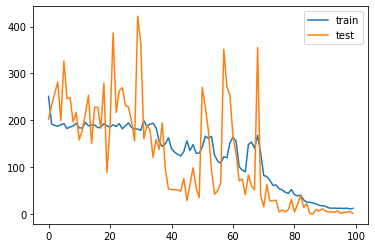

In [339]:
# design network
model = Sequential()
model.add(LSTM(100, input_shape=(x_train.shape[1], x_train.shape[2])))
model.add(Dense(1))

'''
model.add(Dense(120, activation='relu'))
model.add(Dense(80, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
'''

model.compile(loss='mse', optimizer='adam')
# fit network
history = model.fit(x_train, y_train, epochs = 100, batch_size=72, validation_data=(x_test, y_test), verbose=2, shuffle=False)


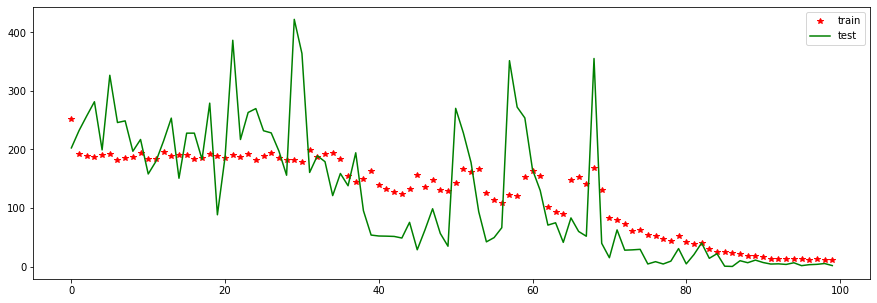

In [358]:
# plot history
plt.figure(figsize=(15, 5))
plt.plot(history.history['loss'], '*', label='train',  color="red")
plt.plot(history.history['val_loss'], '-', label='test', color="green")
plt.legend()
plt.show()

In [352]:
y_pred.reshape(1, -1)[0]

array([3.4347534, 3.4370003, 3.2275467, 2.8685951, 2.8702316, 2.8718872,
       2.9393406, 3.083664 , 3.0185318, 2.888012 , 2.8335438, 2.7236786,
       2.7777348, 2.9009476, 2.7153645, 2.4200764, 2.3783379, 2.295906 ,
       2.2777157, 2.255022 , 2.2119865, 2.1303177, 2.1216698, 2.1252575,
       2.1291904, 2.1334991, 2.130106 , 2.1126347, 2.1382713, 2.1591454,
       2.1127415, 2.1013508, 2.0963058, 2.0880718, 2.077673 , 2.0677948,
       2.0889912, 2.1047115, 2.0547543, 2.0330486, 2.0131779, 2.013258 ,
       2.024332 , 2.0163288, 2.0088406, 2.033121 , 2.0377197, 2.063427 ,
       2.06493  , 2.0737782, 2.0313969, 1.9735184, 1.9756432, 1.9968967,
       2.0008297, 1.9993057, 1.9921513, 1.9781971, 1.9724236, 1.9610214,
       1.9700279, 2.0039177, 2.0286217, 2.1048775, 2.104416 , 2.1039982,
       2.1261883, 2.1839828, 2.2056255, 2.255148 , 2.2685947, 2.29735  ,
       2.23032  , 2.1259575, 2.1096191, 2.079197 , 2.0791035, 2.0790157],
      dtype=float32)

mse:  1.8001072465047347


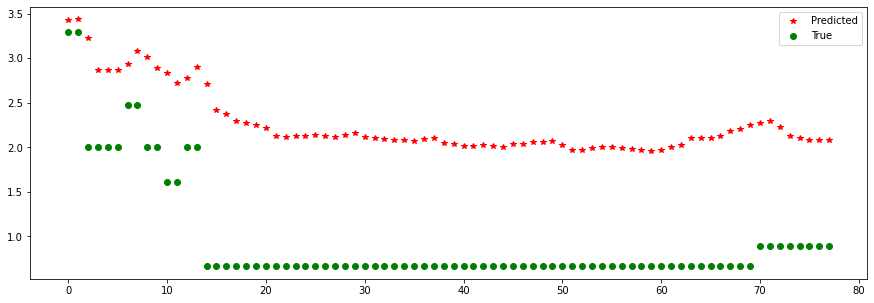

In [356]:
y_pred = model.predict(x_test)

print("mse: ", mean_squared_error(y_test, y_pred))

plt.figure(figsize=(15, 5))
plt.plot(y_pred.reshape(1, -1)[0], '*', color='red')
plt.plot(y_test.values.reshape(1, -1)[0], 'o', color='green')
plt.legend(['Predicted', 'True'])
plt.show()